In [ ]:
import math
import numpy as np
import matplotlib.pyplot as plt
import random
import pandas as pd
from datetime import datetime, timedelta

In [ ]:
print(int(datetime.now().timestamp()))
print('+' if int(datetime.now().timestamp()) % 2 == 0 else '-')

1720363315
-


In [ ]:
def variacao(ultimo, maximo, minimo, fator=0.1):
  media = ((maximo + minimo) / 2)
  if ultimo > media:
    # Calcular a distância ao valor máximo
    distancia = maximo - ultimo
  else:
    # Calcular a distância ao valor mínimo
    distancia = ultimo - minimo

  # Ajustar a variação proporcional à distância ao valor máximo
  return max(0, distancia * fator * np.random.rand())

In [ ]:
def gera_lux(conf: dict, dados: list, falha: bool, tipo_falha: str):
  ultimo_valor = dados[-1]
  # Gera um sinal aleatório
  sinal = '+' if random.randint(1, 10) % 2 == 0 else '-'

  # Gerar dados com o sensor ligado
  if conf['status'] == True:
    if falha == False:
      # Varia o valor entre o máximo e 95% do máximo
      valor = max(conf['maximo'] * 0.95, ultimo_valor + (np.random.rand() * random.choice([-1, 1])))
    else:
      # Verifica o tipo de falha
      if tipo_falha == 'total':
        # Varia entre 20% do máximo e o mínimo
        maximo = conf['maximo'] * np.random.uniform(0.1, 0.25)
        distancia = abs(maximo - ultimo_valor) if ultimo_valor < maximo else ultimo_valor
        valor = min(maximo, ultimo_valor + (distancia * np.random.rand() * random.choice([-1, 1])))
      else:
        # Gera um valor que fica entre 40% a 80%
        maximo = conf['maximo'] * np.random.uniform(0.4, 0.8)
        distancia = abs(maximo - ultimo_valor)
        valor = min(maximo, maximo + (distancia * np.random.rand() * random.choice([-1, 1])))
        # Não retorna valores menores que 40% do máximo
        valor = valor if valor > conf['maximo'] * 0.4 else conf['maximo'] * np.random.uniform(0.35, 0.45)
  else:
    valor = 0

  if valor > conf['maximo']:
    return conf['maximo']
  elif valor < conf['minimo'] and falha == False:
    return conf['minimo']

  return valor if valor > 0 else 0


l_dados = [1]

tamanho = 1000
conf = {'status': True, 'maximo':500, 'minimo': 0}

for _ in range(tamanho):
  l_dados.append(gera_lux(conf=conf, dados=l_dados, falha=False, tipo_falha='parcial'))

for _ in range(tamanho):
  l_dados.append(gera_lux(conf=conf, dados=l_dados, falha=True, tipo_falha='parcial'))

for _ in range(tamanho):
  l_dados.append(gera_lux(conf=conf, dados=l_dados, falha=True, tipo_falha='total'))

for _ in range(tamanho):
  l_dados.append(gera_lux({'status': False, 'maximo':500, 'minimo': 0}, dados=l_dados, falha=True, tipo_falha='total'))

pd.DataFrame(l_dados)

,0
0,1.000000
1,475.000000
2,475.605885
3,475.644793
4,475.181466
...,...
3996,0.000000
3997,0.000000
3998,0.000000
3999,0.000000


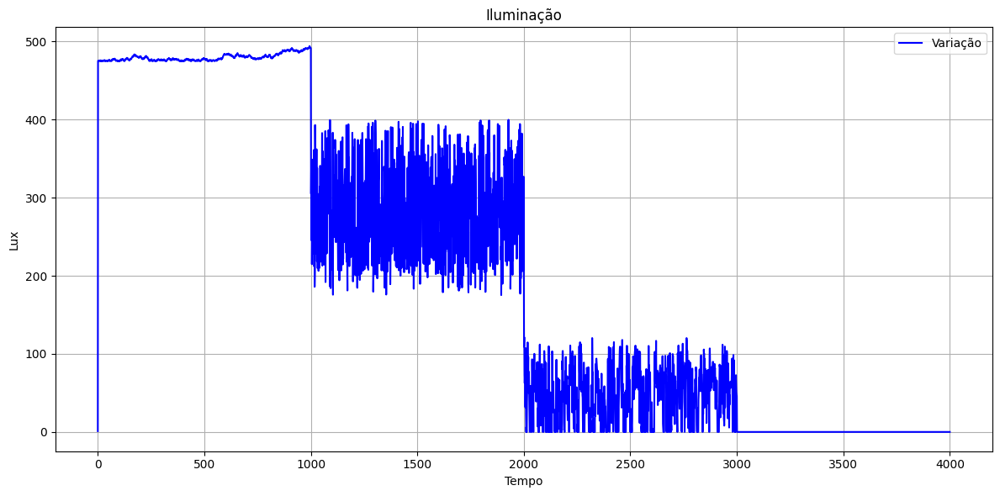

In [ ]:
# Plotar os dados
plt.figure(figsize=(12, 6))

plt.subplot(1, 1, 1)
plt.plot(l_dados, label='Variação', color='blue')
plt.title('Iluminação')
plt.xlabel('Tempo')
plt.ylabel('Lux')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

In [ ]:
def gera_temp(conf: dict, dados: list, falha: bool, tipo_falha: str):
  ultimo_valor = dados[-1]
  if conf['status'] == False:
    return 0

  if falha == False:
    # Varia o valor entre o máximo e 95% do máximo
    return ultimo_valor - variacao(ultimo_valor, conf['maximo'], conf['minimo'], 0.18)
  else:
    # Verifica o tipo de falha
    if tipo_falha == 'total':
      minimo = conf['maximo'] * 0.8 if ultimo_valor > conf['maximo'] * 0.8 else ultimo_valor
      ultimo_valor = minimo if ultimo_valor < minimo else ultimo_valor
      return ultimo_valor + variacao(ultimo_valor + 0.01, conf['maximo'], minimo, 0.18)
    else:
      # Gera um valor que fica entre 40% a 80%
      maximo = conf['maximo'] * 0.8
      return ultimo_valor + variacao(ultimo_valor + 0.01, maximo, conf['minimo'], 0.18)

t_dados = [28]

tamanho = 7*100
conf = {'status': True, 'maximo':32, 'minimo': 23}

for _ in range(tamanho):
  t_dados.append(gera_temp(conf=conf, dados=t_dados, falha=False, tipo_falha='parcial'))

for _ in range(tamanho):
  t_dados.append(gera_temp(conf=conf, dados=t_dados, falha=True, tipo_falha='parcial'))

for _ in range(tamanho):
  t_dados.append(gera_temp(conf=conf, dados=t_dados, falha=True, tipo_falha='total'))

for _ in range(tamanho):
  t_dados.append(gera_temp({'status': False, 'maximo':32, 'minimo': 23}, dados=t_dados, falha=True, tipo_falha='total'))

pd.DataFrame(t_dados)

,0
0,28.000000
1,27.967563
2,27.628488
3,27.357624
4,26.822556
...,...
2796,0.000000
2797,0.000000
2798,0.000000
2799,0.000000


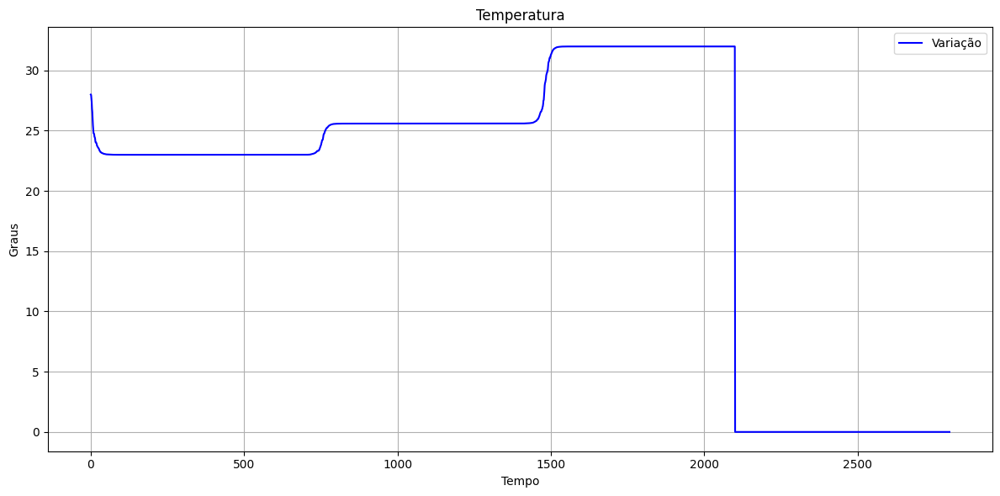

In [ ]:
# Plotar os dados
plt.figure(figsize=(12, 6))

plt.subplot(1, 1, 1)
plt.plot(t_dados, label='Variação', color='blue')
plt.title('Temperatura')
plt.xlabel('Tempo')
plt.ylabel('Graus')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

In [ ]:
def gera_hum(conf: dict, dados: list, falha: bool, tipo_falha: str):
  ultimo_valor = dados[-1]
  if conf['status'] == False:
    return 0

  if falha == False:
    # Varia o valor entre o máximo e 95% do máximo
    return ultimo_valor - variacao(ultimo_valor, conf['maximo'], conf['minimo'], 0.18)
  else:
    # Verifica o tipo de falha
    if tipo_falha == 'total':
      minimo = conf['maximo'] * 0.8 if ultimo_valor > conf['maximo'] * 0.8 else ultimo_valor
      ultimo_valor = minimo if ultimo_valor < minimo else ultimo_valor
      return ultimo_valor + variacao(ultimo_valor + 0.01, conf['maximo'], minimo, 0.18)
    else:
      # Gera um valor que fica entre 40% a 80%
      maximo = conf['maximo'] * 0.8
      return ultimo_valor + variacao(ultimo_valor + 0.01, maximo, conf['minimo'], 0.18)

h_dados = [68]

tamanho = 7*100
conf = {'status': True, 'maximo':75, 'minimo': 45}

for _ in range(tamanho):
  h_dados.append(gera_hum(conf=conf, dados=h_dados, falha=False, tipo_falha='parcial'))

for _ in range(tamanho):
  h_dados.append(gera_hum(conf=conf, dados=h_dados, falha=True, tipo_falha='parcial'))

for _ in range(tamanho):
  h_dados.append(gera_hum(conf=conf, dados=h_dados, falha=True, tipo_falha='total'))

for _ in range(tamanho):
  h_dados.append(gera_hum({'status': False, 'maximo':75, 'minimo': 45}, dados=h_dados, falha=True, tipo_falha='total'))

pd.DataFrame(h_dados)

,0
0,68.000000
1,67.824774
2,67.402889
3,66.950489
4,65.701637
...,...
2796,0.000000
2797,0.000000
2798,0.000000
2799,0.000000


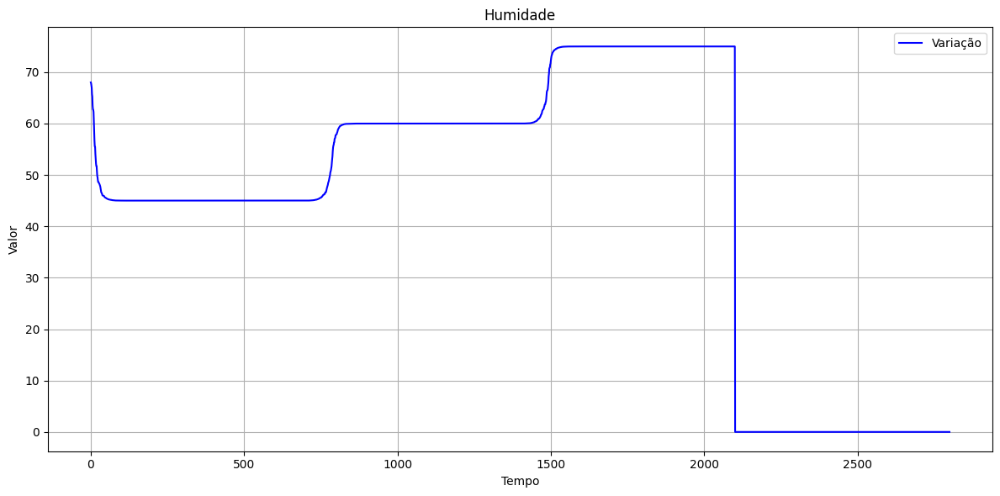

In [ ]:
# Plotar os dados
plt.figure(figsize=(12, 6))

plt.subplot(1, 1, 1)
plt.plot(h_dados, label='Variação', color='blue')
plt.title('Humidade')
plt.xlabel('Tempo')
plt.ylabel('Valor')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

In [ ]:
# Montando o dataset

# Funcionamento normal

tamanho = 500

# Dados dos atuadores
actuators = {'ac_status': 1, 'door_status': 1, 'light_status': 1}

# Dados de temperatura
t_conf = {'status': True if actuators['ac_status'] == 1 else False, 'maximo':32, 'minimo': 23}
t_status = [actuators['ac_status']]

# Dados da humidade
h_conf = {'status': True if actuators['ac_status'] == 1 else False, 'maximo':75, 'minimo': 45}
h_status = [actuators['ac_status']]

# Dados do luximetro
l_conf = {'status': True if actuators['light_status'] == 1 else False, 'maximo':500, 'minimo': 0}
l_status = [actuators['light_status']]

# Gera a lista do status dos atuadores
ac_status = [actuators['ac_status']]
door_status = [actuators['ac_status']]
light_status = [actuators['light_status']]

# 0 = normal, 1 = notificar ar condicionado, 2 = notificar iluminação, 3 = Iluminação e ar condicionado
label = [0]

# Dados inicializados
h_dados = [68]
t_dados = [28]
l_dados = [1]

# Funcionamento Normal
label += [0] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
## Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf=t_conf, dados=t_dados, falha=False, tipo_falha='parcial'))
  t_status.append(actuators['ac_status'])
## Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf=h_conf, dados=h_dados, falha=False, tipo_falha='parcial'))
  h_status.append(actuators['ac_status'])
## Temperatura
for _ in range(tamanho):
  h_dados.append(gera_lux(conf=l_conf, dados=l_dados, falha=False, tipo_falha='parcial'))
  l_status.append(actuators['light_status'])


# Falhas
## Parcial - Caso 1
label += [1] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf=t_conf, dados=t_dados, falha=True, tipo_falha='parcial'))
  t_status.append(actuators['ac_status'])
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf=h_conf, dados=h_dados, falha=True, tipo_falha='parcial'))
  h_status.append(actuators['ac_status'])
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf=l_conf, dados=l_dados, falha=False, tipo_falha='parcial'))
  l_status.append(actuators['light_status'])

## Parcial - Caso 2
label += [2] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf=t_conf, dados=t_dados, falha=False, tipo_falha='parcial'))
  t_status.append(actuators['ac_status'])
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf=h_conf, dados=h_dados, falha=False, tipo_falha='parcial'))
  h_status.append(actuators['ac_status'])
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf=l_conf, dados=l_dados, falha=True, tipo_falha='parcial'))
  l_status.append(actuators['light_status'])

## Parcial - Caso 3
label += [3] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf=t_conf, dados=t_dados, falha=True, tipo_falha='parcial'))
  t_status.append(actuators['ac_status'])
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf=h_conf, dados=h_dados, falha=True, tipo_falha='parcial'))
  h_status.append(actuators['ac_status'])
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf=l_conf, dados=l_dados, falha=True, tipo_falha='parcial'))
  l_status.append(actuators['light_status'])

## Falha total - Cas 1
label += [1] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf=t_conf, dados=t_dados, falha=True, tipo_falha='total'))
  t_status.append(actuators['ac_status'])
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf=h_conf, dados=h_dados, falha=True, tipo_falha='total'))
  h_status.append(actuators['ac_status'])
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf=l_conf, dados=l_dados, falha=False, tipo_falha='total'))
  l_status.append(actuators['light_status'])

## Falha total - Cas 2
label += [2] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf=t_conf, dados=t_dados, falha=False, tipo_falha='total'))
  t_status.append(actuators['ac_status'])
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf=h_conf, dados=h_dados, falha=False, tipo_falha='total'))
  h_status.append(actuators['ac_status'])
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf=l_conf, dados=l_dados, falha=True, tipo_falha='total'))
  l_status.append(actuators['light_status'])

## Falha total - Caso 3
label += [3] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf=t_conf, dados=t_dados, falha=True, tipo_falha='total'))
  t_status.append(actuators['ac_status'])
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf=h_conf, dados=h_dados, falha=True, tipo_falha='total'))
  h_status.append(actuators['ac_status'])
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf=l_conf, dados=l_dados, falha=True, tipo_falha='total'))
  l_status.append(actuators['light_status'])


## Sensor desligado - Caso 1
label += [0] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf={'status': False, 'maximo':32, 'minimo': 23}, dados=t_dados, falha=False, tipo_falha='total'))
  t_status.append(0)
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf={'status': True, 'maximo':75, 'minimo': 45}, dados=h_dados, falha=False, tipo_falha='total'))
  h_status.append(1)
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf={'status': True, 'maximo':500, 'minimo': 0}, dados=l_dados, falha=False, tipo_falha='total'))
  l_status.append(1)

## Sensor desligado - Caso 2
label += [0] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf={'status': True, 'maximo':32, 'minimo': 23}, dados=t_dados, falha=False, tipo_falha='total'))
  t_status.append(1)
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf={'status': False, 'maximo':75, 'minimo': 45}, dados=h_dados, falha=False, tipo_falha='total'))
  h_status.append(0)
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf={'status': True, 'maximo':500, 'minimo': 0}, dados=l_dados, falha=False, tipo_falha='total'))
  l_status.append(1)

## Sensor desligado - Caso 3
label += [0] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf={'status': True, 'maximo':32, 'minimo': 23}, dados=t_dados, falha=False, tipo_falha='total'))
  t_status.append(1)
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf={'status': True, 'maximo':75, 'minimo': 45}, dados=h_dados, falha=False, tipo_falha='total'))
  h_status.append(1)
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf={'status': False, 'maximo':500, 'minimo': 0}, dados=l_dados, falha=False, tipo_falha='total'))
  l_status.append(0)

## Atuador desligado - Ar condicionado
label += [0] * tamanho
actuators['ac_status'] = [0] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [1] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf={'status': True, 'maximo':32, 'minimo': 23}, dados=t_dados, falha=True, tipo_falha='total'))
  t_status.append(1)
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf={'status': True, 'maximo':75, 'minimo': 45}, dados=h_dados, falha=True, tipo_falha='total'))
  h_status.append(1)
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf={'status': True, 'maximo':500, 'minimo': 0}, dados=l_dados, falha=False, tipo_falha='total'))
  l_status.append(1)

## Atuador desligado - Iluminação
label += [0] * tamanho
actuators['ac_status'] = [1] * tamanho
actuators['door_status'] = [1] * tamanho
actuators['light_status'] = [0] * tamanho
### Temperatura
for _ in range(tamanho):
  t_dados.append(gera_temp(conf={'status': True, 'maximo':32, 'minimo': 23}, dados=t_dados, falha=False, tipo_falha='total'))
  t_status.append(1)
### Humidade
for _ in range(tamanho):
  h_dados.append(gera_hum(conf={'status': True, 'maximo':75, 'minimo': 45}, dados=h_dados, falha=False, tipo_falha='total'))
  h_status.append(1)
### Luminosidade
for _ in range(tamanho):
  l_dados.append(gera_lux(conf={'status': True, 'maximo':500, 'minimo': 0}, dados=l_dados, falha=True, tipo_falha='total'))
  l_status.append(1)

timestamp = [datetime(2023, 6, 5, 9, 35, 2).timestamp()]
for _ in range(len(t_dados)):
        t = datetime.fromtimestamp(timestamp[-1]) + timedelta(minutes=1)
        timestamp.append(t.timestamp())

dados = {}
dados['t_dados'] = t_dados
dados['h_dados'] = h_dados
dados['l_dados'] = l_dados
dados['t_status'] = t_status
dados['h_status'] = h_status
dados['l_status'] = l_status
dados['ac_status'] = ac_status
dados['door_status'] = door_status
dados['light_status'] = light_status
dados['label'] = label
dados['timestamp'] = timestamp

df = pd.DataFrame(dados)
df.to_csv('dataset.csv', index=False)

{'t_dados': [28,
  27.544113677290678,
  27.24135710251724,
  27.22907303660039,
  27.005654156328482,
  26.720120288058357,
  26.362035226418485,
  25.97077672078428,
  25.740162585929344,
  25.609651618227147,
  25.435364905054733,
  25.164873089658418,
  24.809064212367435,
  24.553218936821153,
  24.539210250977426,
  24.433451125465616,
  24.20461374725134,
  24.065492653572644,
  24.06450853840508,
  24.030323352680288,
  23.906347054373537,
  23.855916014300163,
  23.80349757243284,
  23.679227308443256,
  23.58844736122367,
  23.524289882740415,
  23.482225443303758,
  23.46339108200734,
  23.430875714693638,
  23.404793942312285,
  23.35925356791903,
  23.35920654030141,
  23.322309288397605,
  23.316961783837492,
  23.28762082365355,
  23.251823167359568,
  23.219421365564067,
  23.214444351773263,
  23.20804458272298,
  23.185314906799643,
  23.161065595804207,
  23.14811911422808,
  23.127494005611464,
  23.112397996961086,
  23.11016769230258,
  23.104244438487527,
  23.10

In [ ]:
# Plotar os dados
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.plot(t_dados, label='Variação', color='blue')
plt.title('Temperatura')
plt.xlabel('Tempo')
plt.ylabel('Graus')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 2)
plt.plot(h_dados, label='Variação', color='green')
plt.title('Humidade')
plt.xlabel('Tempo')
plt.ylabel('Valor')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 3)
plt.plot(h_dados, label='Variação', color='red')
plt.title('Iluminação')
plt.xlabel('Tempo')
plt.ylabel('Lux')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()